In [ ]:
!git clone https://github.com/cyalla/img2pose.git

Cloning into 'img2pose'...
remote: Enumerating objects: 326, done.
remote: Counting objects: 100% (113/113), done.
remote: Compressing objects: 100% (65/65), done.
remote: Total 326 (delta 61), reused 91 (delta 48), pack-reused 213
Receiving objects: 100% (326/326), 15.41 MiB | 21.71 MiB/s, done.
Resolving deltas: 100% (150/150), done.


In [ ]:
#download the datasets and upload to google drive 

# Below 3 DataSets used for testing ,training and evaluation

# 1)Training of model done WIDERFACE  (http://shuoyang1213.me/WIDERFACE/)
#        WIDER Face Training Images  
#        WIDER Face Validation Images  
#        WIDER Face Testing Images 

# 2)Evaluation dataset 1 AFLW2000-3D http://www.cbsr.ia.ac.cn/users/xiangyuzhu/projects/3DDFA/Database/AFLW2000-3D.zip

# 3)Evaluation dataset 2 BIWI
# http://data.vision.ee.ethz.ch/cvl/gfanelli/kinect_head_pose_db.tgz


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
cd /content/img2pose

/content/img2pose


In [ ]:
!pip install -r requirements.txt


In [ ]:
cd Sim3DR

/content/img2pose/Sim3DR


In [ ]:
!sh build_sim3dr.sh

In [ ]:
cd .. 

/content/img2pose


In [ ]:
mkdir datasets

In [ ]:
cd  datasets

/content/img2pose/datasets


In [ ]:
mkdir WIDER_Face

In [ ]:
cd WIDER_Face

/content/img2pose/datasets/WIDER_Face


In [ ]:
ls

In [ ]:
!unzip /content/drive/MyDrive/data/WIDER_train.zip

In [ ]:
ls

WIDER_train/


In [ ]:
!unzip /content/drive/MyDrive/data/WIDER_test.zip

In [ ]:
ls


WIDER_test/  WIDER_train/


In [ ]:
!unzip /content/drive/MyDrive/data/WIDER_val.zip

In [ ]:
ls

WIDER_test/  WIDER_train/  WIDER_val/


In [ ]:
cd ../..

/content/img2pose


In [ ]:
ls

config.py                      img2pose.py       rpn.py
convert_json_list_to_lmdb.py   license.md        run_face_alignment.py
data_loader_lmdb_augmenter.py  losses.py         Sim3DR/
data_loader_lmdb.py            model_loader.py   teaser.jpeg
datasets/                      models.py         train_logger.py
early_stop.py                  pose_references/  train.py
evaluation/                    README.md         utils/
generalized_rcnn.py            requirements.txt


In [ ]:
!unzip /content/drive/MyDrive/data/annotations.zip

In [ ]:
ls

annotations/                   generalized_rcnn.py  requirements.txt
config.py                      img2pose.py          rpn.py
convert_json_list_to_lmdb.py   license.md           run_face_alignment.py
data_loader_lmdb_augmenter.py  losses.py            Sim3DR/
data_loader_lmdb.py            model_loader.py      teaser.jpeg
datasets/                      models.py            train_logger.py
early_stop.py                  pose_references/     train.py
evaluation/                    README.md            utils/


In [ ]:
!python3 convert_json_list_to_lmdb.py --json_list ./annotations/WIDER_train_annotations.txt --dataset_path ./datasets/WIDER_Face/WIDER_train/images/ --dest ./datasets/lmdb/ --train


Loading dataset from ./annotations/WIDER_train_annotations.txt
Loading frames paths...
100% 12880/12880 [00:03<00:00, 3892.99it/s]
Generate LMDB to ./datasets/lmdb/WIDER_train_annotations.lmdb
LMDB max size: 55641600000
Total number of samples: 12880
0it [00:00, ?it/s][0/12880]
4996it [01:07, 200.59it/s][5000/12880]
9997it [02:10, 81.87it/s][10000/12880]
12880it [02:39, 80.67it/s]
12874
Flushing database ...
Saving pose mean and std dev.


In [ ]:
!python3 convert_json_list_to_lmdb.py  --json_list ./annotations/WIDER_val_annotations.txt  --dataset_path ./datasets/WIDER_Face/WIDER_val/images/  --dest ./datasets/lmdb

Loading dataset from ./annotations/WIDER_val_annotations.txt
Loading frames paths...
100% 3226/3226 [00:00<00:00, 3647.93it/s]
Generate LMDB to ./datasets/lmdb/WIDER_val_annotations.lmdb
LMDB max size: 13936320000
Total number of samples: 3226
0it [00:00, ?it/s][0/3226]
3226it [00:38, 84.70it/s] 
3205
Flushing database ...


In [ ]:
#train the model for 1 epochs

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python3 train.py \
--pose_mean ./datasets/lmdb/WIDER_train_annotations_pose_mean.npy \
--pose_stddev ./datasets/lmdb/WIDER_train_annotations_pose_stddev.npy \
--workspace ./workspace/ \
--train_source ./datasets/lmdb/WIDER_train_annotations.lmdb \
--val_source ./datasets/lmdb/WIDER_val_annotations.lmdb \
--prefix trial_1 \
--epochs 1 \
--batch_size 2 \
--lr_plateau \
--early_stop \
--random_flip \
--random_crop \
--max_size 1400

In [ ]:
!unzip /content/drive/MyDrive/data/models.zip

Archive:  /content/drive/MyDrive/data/models.zip
   creating: models/
  inflating: models/WIDER_train_pose_mean_v1.npy  
  inflating: models/img2pose_v1.pth  
  inflating: models/WIDER_train_pose_stddev_v1.npy  


In [ ]:
ls models

img2pose_v1.pth  WIDER_train_pose_mean_v1.npy  WIDER_train_pose_stddev_v1.npy


In [ ]:
cd datasets/WIDER_Face/

/content/img2pose/datasets/WIDER_Face


In [ ]:
!unzip /content/drive/MyDrive/data/wider_face_split.zip

Archive:  /content/drive/MyDrive/data/wider_face_split.zip
  inflating: wider_face_split/readme.txt  
  inflating: wider_face_split/wider_face_test.mat  
  inflating: wider_face_split/wider_face_test_filelist.txt  
  inflating: wider_face_split/wider_face_train.mat  
  inflating: wider_face_split/wider_face_train_bbx_gt.txt  
  inflating: wider_face_split/wider_face_val.mat  
  inflating: wider_face_split/wider_face_val_bbx_gt.txt  


In [ ]:
ls

wider_face_split/  WIDER_test/  WIDER_train/  WIDER_val/


In [ ]:
cd ../../

/content/img2pose


In [ ]:
#running aflw_2000_3d_evaluation.ipynb

In [ ]:
import sys
sys.path.append('../../')
import numpy as np
import torch
from torchvision import transforms
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
from PIL import Image, ImageOps
from scipy.spatial.transform import Rotation
import pandas as pd
from scipy.spatial import distance
import time
import os
import math
import scipy.io as sio
from utils.renderer import Renderer
from utils.image_operations import expand_bbox_rectangle
from utils.pose_operations import get_pose
from img2pose import img2poseModel
from model_loader import load_model

np.set_printoptions(suppress=True)

In [ ]:
cd /content/img2pose/evaluation/jupyter_notebooks

/content/img2pose/evaluation/jupyter_notebooks


In [ ]:
dataset_path = "AFLW2000_annotations.txt"
test_dataset = pd.read_csv(dataset_path, delimiter=" ", header=None)
test_dataset = np.asarray(test_dataset).squeeze()  

In [ ]:
def bb_intersection_over_union(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
    iou = interArea / float(boxAArea + boxBArea - interArea)
    return iou

def render_plot(img, pose_pred):
    (w, h) = img.size
    image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])

    trans_vertices = renderer.transform_vertices(img, [pose_pred])
    img = renderer.render(img, trans_vertices, alpha=1)    

    plt.figure(figsize=(8, 8))        

    plt.imshow(img)        
    plt.show()
    
def convert_to_aflw(rotvec, is_rotvec=True):
    if is_rotvec:
        rotvec = Rotation.from_rotvec(rotvec).as_matrix()
    rot_mat_2 = np.transpose(rotvec)
    angle = Rotation.from_matrix(rot_mat_2).as_euler('xyz', degrees=True)
    
    return np.array([angle[0], -angle[1], -angle[2]])

In [ ]:
renderer = Renderer(
    vertices_path="../../pose_references/vertices_trans.npy", 
    triangles_path="../../pose_references/triangles.npy"
)

threed_points = np.load('../../pose_references/reference_3d_68_points_trans.npy')

In [ ]:
transform = transforms.Compose([transforms.ToTensor()])

DEPTH = 18
MAX_SIZE = 1400
MIN_SIZE = 400

POSE_MEAN = "../../models/WIDER_train_pose_mean_v1.npy"
POSE_STDDEV = "../../models/WIDER_train_pose_stddev_v1.npy"
# MODEL_PATH = "../../models/img2pose_v1_ft_300w_lp.pth"
MODEL_PATH = "../../models/img2pose_v1.pth"

pose_mean = np.load(POSE_MEAN)
pose_stddev = np.load(POSE_STDDEV)


img2pose_model = img2poseModel(
    DEPTH, MIN_SIZE, MAX_SIZE, 
    pose_mean=pose_mean, pose_stddev=pose_stddev,
    threed_68_points=threed_points,
    rpn_pre_nms_top_n_test=500,
    rpn_post_nms_top_n_test=10,
)
load_model(img2pose_model.fpn_model, MODEL_PATH, cpu_mode=str(img2pose_model.device) == "cpu", model_only=True)
img2pose_model.evaluate()

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth



Model will use 1 GPUs!


In [ ]:
cd /content/img2pose/datasets

/content/img2pose/datasets


In [ ]:
ls

lmdb/  WIDER_Face/


In [ ]:
!unzip /content/drive/MyDrive/data/AFLW2000-3D.zip

In [ ]:
cd /content/img2pose/evaluation/jupyter_notebooks

/content/img2pose/evaluation/jupyter_notebooks


In [ ]:
visualize = False
total_imgs = len(test_dataset)

threshold = 0.0
targets = []
predictions = []

total_failures = 0
times = []

for img_path in tqdm(test_dataset[:total_imgs]):
    img = Image.open(img_path).convert("RGB")

    image_name = os.path.split(img_path)[1]

    ori_img = img.copy()

    (w, h) = ori_img.size
    image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])

    mat_contents = sio.loadmat(img_path[:-4] + ".mat")
    target_points = np.asarray(mat_contents['pt3d_68']).T[:, :2]

    _, pose_target = get_pose(threed_points, target_points, image_intrinsics)

    target_bbox = expand_bbox_rectangle(w, h, 1.1, 1.1, target_points, roll=pose_target[2])

    pose_para = np.asarray(mat_contents['Pose_Para'])[0][:3]
    pose_para_degrees = pose_para[:3] * (180 / math.pi)

    if np.any(np.abs(pose_para_degrees) > 99):
        continue        

    run_time = 0
    time1 = time.time()
    res = img2pose_model.predict([transform(img)])
    time2 = time.time()
    run_time += (time2 - time1)

    res = res[0]

    bboxes = res["boxes"].cpu().numpy().astype('float')
    max_iou = 0
    best_index = -1

    for i in range(len(bboxes)):
        if res["scores"][i] > threshold:
            bbox = bboxes[i]
            pose_pred = res["dofs"].cpu().numpy()[i].astype('float')
            pose_pred = np.asarray(pose_pred.squeeze())   
            iou = bb_intersection_over_union(bbox, target_bbox)

            if iou > max_iou:
                max_iou = iou
                best_index = i    

    if best_index >= 0:
        bbox = bboxes[best_index]
        pose_pred = res["dofs"].cpu().numpy()[best_index].astype('float')
        pose_pred = np.asarray(pose_pred.squeeze())        

        
        if visualize and best_index >= 0:    
            render_plot(ori_img.copy(), pose_pred)

    if len(bboxes) == 0:
        total_failures += 1

        continue

    times.append(run_time)

    pose_target[:3] = pose_para_degrees  
    pose_pred[:3] = convert_to_aflw(pose_pred[:3])

    targets.append(pose_target)
    predictions.append(pose_pred)

pose_mae = np.mean(abs(np.asarray(predictions) - np.asarray(targets)), axis=0)
threed_pose = pose_mae[:3]
trans_pose = pose_mae[3:]

print(f"Model failed on {total_failures} images")
print(f"Yaw: {threed_pose[1]:.3f} Pitch: {threed_pose[0]:.3f} Roll: {threed_pose[2]:.3f} MAE: {np.mean(threed_pose):.3f}")
print(f"H. Trans.: {trans_pose[0]:.3f} V. Trans.: {trans_pose[1]:.3f} Scale: {trans_pose[2]:.3f} MAE: {np.mean(trans_pose):.3f}")
print(f"Average time {np.mean(np.asarray(times))}")


Model failed on 0 images
Yaw: 4.539 Pitch: 8.320 Roll: 5.586 MAE: 6.148
H. Trans.: 0.032 V. Trans.: 0.046 Scale: 0.268 MAE: 0.115
Average time 0.033266749219763636


In [ ]:
#biwi_evaluation.ipynb

In [ ]:
import sys
sys.path.append('../../')
import numpy as np
import torch
from torchvision import transforms
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
from PIL import Image, ImageOps
from scipy.spatial.transform import Rotation
import pandas as pd
from scipy.spatial import distance
import time
import os
import math
import scipy.io as sio
from utils.renderer import Renderer
from img2pose import img2poseModel
from model_loader import load_model

np.set_printoptions(suppress=True)

In [ ]:
def bb_intersection_over_union(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])

    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
    iou = interArea / float(boxAArea + boxBArea - interArea)
    return iou

def render_plot(img, pose_pred):
    (w, h) = img.size
    image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])

    trans_vertices = renderer.transform_vertices(img, [pose_pred])
    img = renderer.render(img, trans_vertices, alpha=1)    

    plt.figure(figsize=(16, 16))        

    plt.imshow(img)        
    plt.show()
    
def convert_to_aflw(rotvec, is_rotvec=True):
    if is_rotvec:
        rotvec = Rotation.from_rotvec(rotvec).as_matrix()
    rot_mat_2 = np.transpose(rotvec)
    angle = Rotation.from_matrix(rot_mat_2).as_euler('xyz', degrees=True)
    
    return np.array([angle[0], -angle[1], -angle[2]])

In [ ]:
ls ../../datasets/

AFLW2000/  lmdb/  WIDER_Face/


In [ ]:
cd /content/img2pose/datasets

/content/img2pose/datasets


In [ ]:
!unzip /content/drive/MyDrive/data/BIWI.zip

In [ ]:
cd /content/img2pose/evaluation/jupyter_notebooks

/content/img2pose/evaluation/jupyter_notebooks


In [ ]:
ls

aflw_2000_3d_evaluation.ipynb  biwi_evaluation.ipynb
AFLW2000_annotations.txt       test_own_images.ipynb
BIWI_annotations.txt           visualize_trained_model_predictions.ipynb


In [ ]:
dataset_path = "./BIWI_annotations.txt"
dataset = pd.read_csv(dataset_path, delimiter=" ", header=None)
dataset = np.asarray(dataset).squeeze()

pose_targets = []
test_dataset = []

for sample in dataset:
    img_path = sample[0]
        
    annotations = open(img_path.replace("_rgb.png", "_pose.txt"))
    lines = annotations.readlines()
    
    pose_target = []
    for i in range(3):
        lines[i] = str(lines[i].rstrip("\n")) 
        pose_target.append(lines[i].split(" ")[:3])
    
    pose_target = np.asarray(pose_target).astype(float)     
    pose_target = convert_to_aflw(pose_target, False)
    pose_targets.append(pose_target)
    
    test_dataset.append(img_path)

In [ ]:
renderer = Renderer(
    vertices_path="../../pose_references/vertices_trans.npy", 
    triangles_path="../../pose_references/triangles.npy"
)

threed_points = np.load('../../pose_references/reference_3d_68_points_trans.npy')

In [ ]:
transform = transforms.Compose([transforms.ToTensor()])

DEPTH = 18
MAX_SIZE = 1400
MIN_SIZE = 700

POSE_MEAN = "../../models/WIDER_train_pose_mean_v1.npy"
POSE_STDDEV = "../../models/WIDER_train_pose_stddev_v1.npy"
MODEL_PATH = "../../models/img2pose_v1.pth"
pose_mean = np.load(POSE_MEAN)
pose_stddev = np.load(POSE_STDDEV)

img2pose_model = img2poseModel(
    DEPTH, MIN_SIZE, MAX_SIZE, 
    pose_mean=pose_mean, pose_stddev=pose_stddev,
    threed_68_points=threed_points,
    rpn_pre_nms_top_n_test=500,
    rpn_post_nms_top_n_test=10,
)
load_model(img2pose_model.fpn_model, MODEL_PATH, cpu_mode=str(img2pose_model.device) == "cpu", model_only=True)
img2pose_model.evaluate()

Model will use 1 GPUs!


In [ ]:
visualize = False
total_imgs = len(test_dataset)
threshold = 0.9

predictions = []
targets = []

total_failures = 0
times = []

for j in tqdm(range(total_imgs)):
    img = Image.open(test_dataset[j]).convert("RGB")
    (w, h) = img.size
    pose_target = pose_targets[j]
    ori_img = img.copy()
    
    time1 = time.time()
    res = img2pose_model.predict([transform(img)])
    time2 = time.time()
    times.append(time2 - time1)

    res = res[0]

    bboxes = res["boxes"].cpu().numpy().astype('float')

    min_dist_center = float("Inf")
    best_index = 0

    if len(bboxes) == 0:
        total_failures += 1        
        continue

    for i in range(len(bboxes)):
        if res["scores"][i] > threshold:
            bbox = bboxes[i]
            bbox_center_x = bbox[0] + ((bbox[2] - bbox[0]) // 2)
            bbox_center_y = bbox[1] + ((bbox[3] - bbox[1]) // 2)

            dist_center = distance.euclidean([bbox_center_x, bbox_center_y], [w // 2, h // 2])

            if dist_center < min_dist_center:
                min_dist_center = dist_center
                best_index = i        

    bbox = bboxes[best_index]
    pose_pred = res["dofs"].cpu().numpy()[best_index].astype('float')
    pose_pred = np.asarray(pose_pred.squeeze())

    if best_index >= 0:
        bbox = bboxes[best_index]
        pose_pred = res["dofs"].cpu().numpy()[best_index].astype('float')
        pose_pred = np.asarray(pose_pred.squeeze())
                 

    if visualize and best_index >= 0:     
        render_plot(ori_img.copy(), pose_pred)

    if len(bboxes) == 0:
        total_failures += 1

        continue
    
    pose_pred = convert_to_aflw(pose_pred[:3])
    
    predictions.append(pose_pred[:3])
    targets.append(pose_target[:3])

pose_mae = np.mean(abs(np.asarray(predictions) - np.asarray(targets)), axis=0)
threed_pose = pose_mae[:3]

print(f"Model failed on {total_failures} images")
print(f"Yaw: {threed_pose[1]:.3f} Pitch: {threed_pose[0]:.3f} Roll: {threed_pose[2]:.3f} MAE: {np.mean(threed_pose):.3f}")
print(f"Average time {np.mean(np.asarray(times))}")


Model failed on 0 images
Yaw: 3.735 Pitch: 5.612 Roll: 3.317 MAE: 4.222
Average time 0.05459961444601655


In [ ]:
#test_own_images.ipynb

In [ ]:
import sys
sys.path.append('../../')
import numpy as np
import torch
from torchvision import transforms
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
from PIL import Image, ImageOps
import matplotlib.patches as patches
from scipy.spatial.transform import Rotation
import pandas as pd
from scipy.spatial import distance
import time
import os
import math
import scipy.io as sio
from utils.renderer import Renderer
from utils.image_operations import expand_bbox_rectangle
from utils.pose_operations import get_pose
from img2pose import img2poseModel
from model_loader import load_model

np.set_printoptions(suppress=True)

In [ ]:
def render_plot(img, poses, bboxes):
    (w, h) = img.size
    image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])
    
    trans_vertices = renderer.transform_vertices(img, poses)
    img = renderer.render(img, trans_vertices, alpha=1)    

    plt.figure(figsize=(8, 8))     
    
    for bbox in bboxes:
        plt.gca().add_patch(patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1],linewidth=3,edgecolor='b',facecolor='none'))            
    
    plt.imshow(img)        
    plt.show()

In [ ]:
renderer = Renderer(
    vertices_path="../../pose_references/vertices_trans.npy", 
    triangles_path="../../pose_references/triangles.npy"
)

threed_points = np.load('../../pose_references/reference_3d_68_points_trans.npy')

In [ ]:
transform = transforms.Compose([transforms.ToTensor()])

DEPTH = 18
MAX_SIZE = 1400
MIN_SIZE = 600

POSE_MEAN = "../../models/WIDER_train_pose_mean_v1.npy"
POSE_STDDEV = "../../models/WIDER_train_pose_stddev_v1.npy"
MODEL_PATH = "../../models/img2pose_v1.pth"

pose_mean = np.load(POSE_MEAN)
pose_stddev = np.load(POSE_STDDEV)

img2pose_model = img2poseModel(
    DEPTH, MIN_SIZE, MAX_SIZE, 
    pose_mean=pose_mean, pose_stddev=pose_stddev,
    threed_68_points=threed_points,
)
load_model(img2pose_model.fpn_model, MODEL_PATH, cpu_mode=str(img2pose_model.device) == "cpu", model_only=True)
img2pose_model.evaluate()

Model will use 1 GPUs!


In [ ]:
cd /content/img2pose/datasets

/content/img2pose/datasets


In [ ]:
ls

AFLW2000/  BIWI/  lmdb/  WIDER_Face/


In [ ]:
#upload your customer images as zip file (peopleimages.zip) in google drive data folder and use for your testing

In [ ]:
!unzip /content/drive/MyDrive/data/peopleimages.zip

Archive:  /content/drive/MyDrive/data/peopleimages.zip
   creating: peopleimages/
  inflating: peopleimages/people2.jpeg  
  inflating: peopleimages/people3.jpeg  
  inflating: peopleimages/people4.jpeg  
  inflating: peopleimages/people5.jpeg  
  inflating: peopleimages/people1.jpeg  


In [ ]:
!pwd



/content/img2pose/datasets


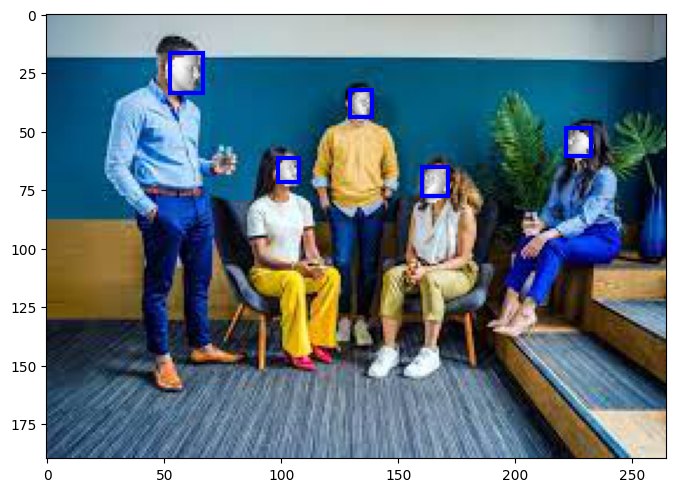

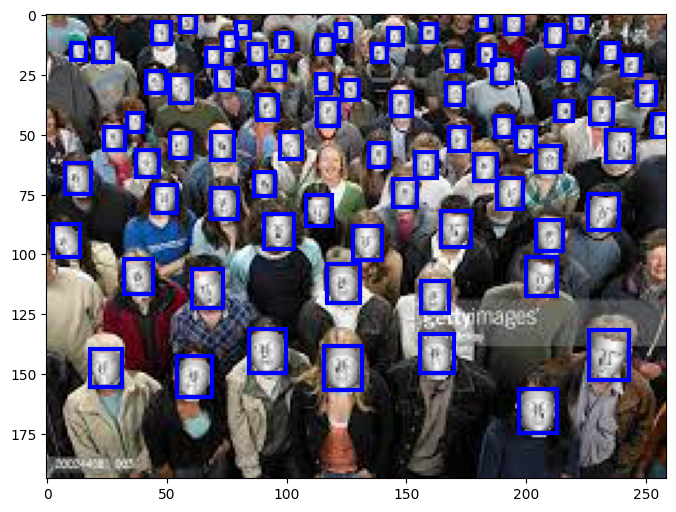

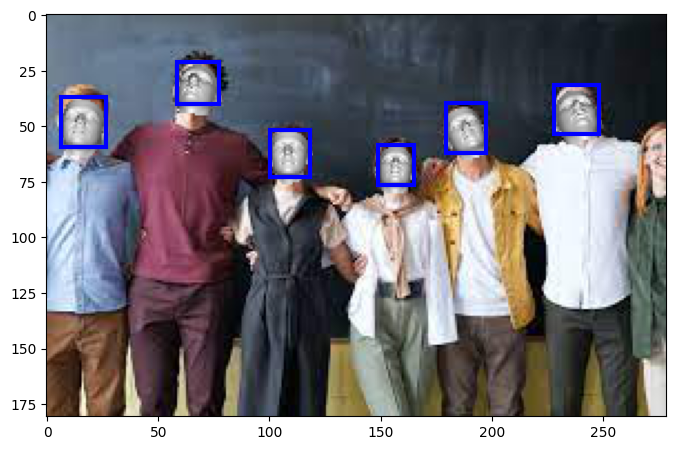

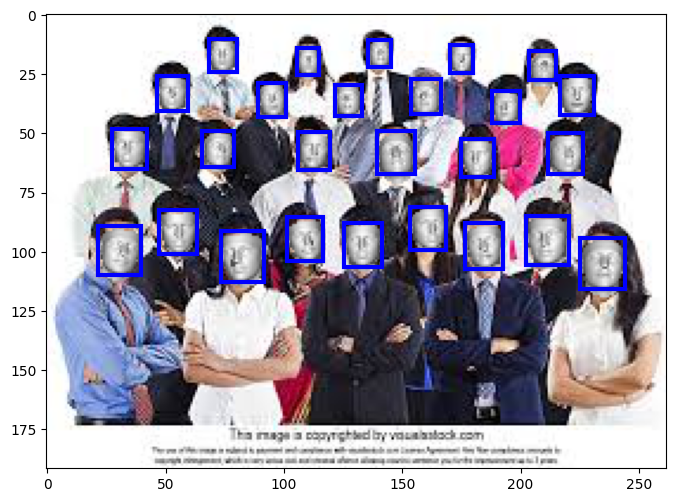

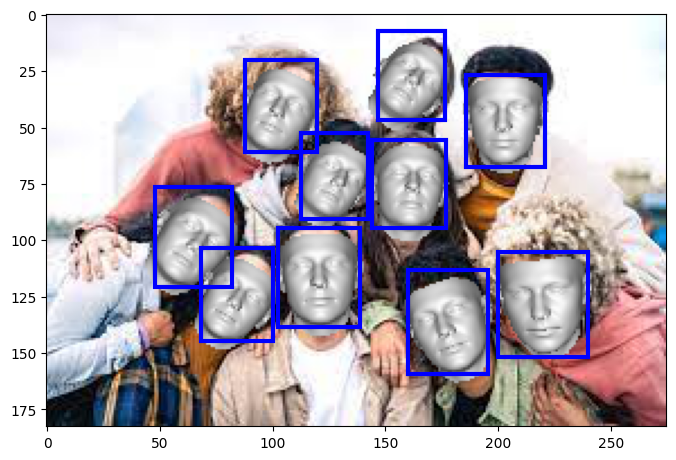

In [ ]:
# change to a folder with images, or another list containing image paths
images_path = "/content/img2pose/datasets/peopleimages"

threshold = 0.9

if os.path.isfile(images_path):
    img_paths = pd.read_csv(images_path, delimiter=" ", header=None)
    img_paths = np.asarray(img_paths).squeeze()
else:
    img_paths = [os.path.join(images_path, img_path) for img_path in os.listdir(images_path)]

for img_path in tqdm(img_paths):
    img = Image.open(img_path).convert("RGB")
    
    image_name = os.path.split(img_path)[1]
    
    (w, h) = img.size
    image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])
            
    res = img2pose_model.predict([transform(img)])[0]

    all_bboxes = res["boxes"].cpu().numpy().astype('float')

    poses = []
    bboxes = []
    for i in range(len(all_bboxes)):
        if res["scores"][i] > threshold:
            bbox = all_bboxes[i]
            pose_pred = res["dofs"].cpu().numpy()[i].astype('float')
            pose_pred = pose_pred.squeeze()

            poses.append(pose_pred)  
            bboxes.append(bbox)

    render_plot(img.copy(), poses, bboxes)

In [ ]:
#visualize_trained_model_predictions

In [ ]:
cd /content/img2pose/evaluation/jupyter_notebooks

/content/img2pose/evaluation/jupyter_notebooks


In [ ]:
from os import path

import lmdb
import msgpack
import numpy as np
import six
import torch
from PIL import Image
from torch.utils.data import BatchSampler, DataLoader, Dataset
from torch.utils.data.distributed import DistributedSampler
from torchvision import transforms

import utils.augmentation as augmentation
from utils.image_operations import expand_bbox_rectangle
from utils.pose_operations import plot_3d_landmark, pose_bbox_to_full_image


class LMDB(Dataset):
    def __init__(
        self,
        config,
        db_path,
        transform=None,
        pose_label_transform=None,
        augmentation_methods=None,
    ):
        self.config = config
        self.env = lmdb.open(
            db_path,
            subdir=path.isdir(db_path),
            readonly=True,
            lock=False,
            readahead=False,
            meminit=False,
        )

        with self.env.begin(write=False) as txn:
            self.length = msgpack.loads(txn.get(b"__len__"))
            self.keys = msgpack.loads(txn.get(b"__keys__"))

        self.transform = transform
        self.pose_label_transform = pose_label_transform
        self.augmentation_methods = augmentation_methods
        self.threed_68_points = np.load(self.config.threed_68_points)

    def __getitem__(self, index):
        img, target = None, None
        env = self.env
        with env.begin(write=False) as txn:
            byteflow = txn.get(self.keys[index])
        data = msgpack.loads(byteflow)

        # load image
        imgbuf = data[0]
        buf = six.BytesIO()
        buf.write(imgbuf)
        buf.seek(0)
        img = Image.open(buf).convert("RGB")

        # load local pose label
        pose_labels = np.asarray(data[3])

        # load bbox
        bbox_labels = np.asarray(data[2])

        # load landmarks label
        landmark_labels = data[4]

        # apply augmentations that are provided from the parent class
        for augmentation_method in self.augmentation_methods:
            img, _, _ = augmentation_method(img, None, None)

        # create global intrinsics
        (w, h) = img.size
        global_intrinsics = np.array(
            [[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]]
        )

        img = np.array(img)
        projected_bbox_labels = []
        new_pose_labels = []
        # get projected bboxes
        for i in range(len(pose_labels)):
            pose_label = pose_labels[i]
            bbox = bbox_labels[i]

            lms = np.asarray(landmark_labels[i])

            # black out faces that do not have pose annotation
            if -1 in lms:
                img[int(bbox[1]) : int(bbox[3]), int(bbox[0]) : int(bbox[2]), :] = 0
                continue

            # convert to global image
            pose_label = pose_bbox_to_full_image(pose_label, global_intrinsics, bbox)

            # project points and get bbox
            projected_lms, _ = plot_3d_landmark(
                self.threed_68_points, pose_label, global_intrinsics
            )
            projected_bbox = expand_bbox_rectangle(
                w, h, 1.1, 1.1, projected_lms, roll=pose_label[2]
            )

            projected_bbox_labels.append(projected_bbox)

            new_pose_labels.append(pose_label)

        img = Image.fromarray(img)

        if self.transform is not None:
            img = self.transform(img)

        target = {
            "dofs": torch.from_numpy(np.asarray(new_pose_labels)).float(),
            "boxes": torch.from_numpy(np.asarray(projected_bbox_labels)).float(),
            "labels": torch.ones((len(projected_bbox_labels),), dtype=torch.int64),
        }

        return img, target

    def __len__(self):
        return self.length


class LMDBDataLoader(DataLoader):
    def __init__(self, config, lmdb_path, train=True):
        self.config = config

        transform = transforms.Compose([transforms.ToTensor()])

        augmentation_methods = []

        if train:
            if self.config.noise_augmentation:
                augmentation_methods.append(augmentation.add_noise)

            if self.config.contrast_augmentation:
                augmentation_methods.append(augmentation.change_contrast)

        if self.config.pose_mean is not None:
            pose_label_transform = self.normalize_pose_labels
        else:
            pose_label_transform = None

        self._dataset = LMDB(
            config, lmdb_path, transform, pose_label_transform, augmentation_methods
        )

        if config.distributed:
            self._sampler = DistributedSampler(self._dataset, shuffle=False)

            if train:
                self._sampler = BatchSampler(
                    self._sampler, config.batch_size, drop_last=True
                )

                super(LMDBDataLoader, self).__init__(
                    self._dataset,
                    batch_sampler=self._sampler,
                    pin_memory=config.pin_memory,
                    num_workers=config.workers,
                    collate_fn=collate_fn,
                )
            else:
                super(LMDBDataLoader, self).__init__(
                    self._dataset,
                    config.batch_size,
                    drop_last=False,
                    sampler=self._sampler,
                    pin_memory=config.pin_memory,
                    num_workers=config.workers,
                    collate_fn=collate_fn,
                )

        else:
            super(LMDBDataLoader, self).__init__(
                self._dataset,
                batch_size=config.batch_size,
                shuffle=train,
                pin_memory=config.pin_memory,
                num_workers=config.workers,
                drop_last=True,
                collate_fn=collate_fn,
            )

    def normalize_pose_labels(self, pose_labels):
        for i in range(len(pose_labels)):
            pose_labels[i] = (
                pose_labels[i] - self.config.pose_mean
            ) / self.config.pose_stddev

        return pose_labels


def collate_fn(batch):
    return tuple(zip(*batch))


In [ ]:
import sys
sys.path.append('../../')
import numpy as np
import torch
from torchvision import transforms
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
from PIL import Image, ImageOps
import matplotlib.patches as patches
from scipy.spatial.transform import Rotation
import pandas as pd
from scipy.spatial import distance
import time
import os
import math
import scipy.io as sio
import random
from utils.renderer import Renderer
from utils.image_operations import expand_bbox_rectangle
from utils.pose_operations import get_pose
from img2pose import img2poseModel
from model_loader import load_model
from dataclasses import dataclass

np.set_printoptions(suppress=True)

torch.random.manual_seed(42)
np.random.seed(42)

@dataclass
class Config:
    batch_size: int
    pin_memory: bool
    workers: int
    pose_mean: np.array
    pose_stddev: np.array
    noise_augmentation: bool
    contrast_augmentation: bool
    threed_68_points: str
    distributed: bool

In [ ]:
renderer = Renderer(
    vertices_path="../../pose_references/vertices_trans.npy", 
    triangles_path="../../pose_references/triangles.npy"
)

threed_points = np.load('../../pose_references/reference_3d_68_points_trans.npy')

In [ ]:
transform = transforms.Compose([transforms.ToTensor()])

# bounding box customization
# how much to expand in the width
BBOX_X_FACTOR = 1.1
# how much to expand in height
BBOX_Y_FACTOR = 1.1
# how much to expand the forehead
EXPAND_FOREHEAD = 0.3

DEPTH = 18
MAX_SIZE = 1400
MIN_SIZE = 600

POSE_MEAN = "../../models/WIDER_train_pose_mean_v1.npy"
POSE_STDDEV = "../../models/WIDER_train_pose_stddev_v1.npy"
MODEL_PATH = "../../models/img2pose_v1.pth"

pose_mean = np.load(POSE_MEAN)
pose_stddev = np.load(POSE_STDDEV)

img2pose_model = img2poseModel(
    DEPTH, MIN_SIZE, MAX_SIZE, 
    pose_mean=pose_mean, pose_stddev=pose_stddev,
    threed_68_points=threed_points,    
    bbox_x_factor=BBOX_X_FACTOR,
    bbox_y_factor=BBOX_Y_FACTOR,
    expand_forehead=EXPAND_FOREHEAD,
)
load_model(img2pose_model.fpn_model, MODEL_PATH, cpu_mode=str(img2pose_model.device) == "cpu", model_only=True)
img2pose_model.evaluate()

Model will use 1 GPUs!


In [ ]:
LMDB_FILE = "../../datasets/lmdb/WIDER_val_annotations.lmdb"

# load images that were already compressed from json list to lmdb file
lmdb_data_loader = LMDBDataLoader(
    Config(
        batch_size=1,
        pin_memory=True,
        workers=1,
        pose_mean=pose_mean,
        pose_stddev=pose_stddev,
        noise_augmentation=False,
        contrast_augmentation=False,
        threed_68_points='../../pose_references/reference_3d_68_points_trans.npy',
        distributed=False
    ),
    LMDB_FILE,
    train=True,
)

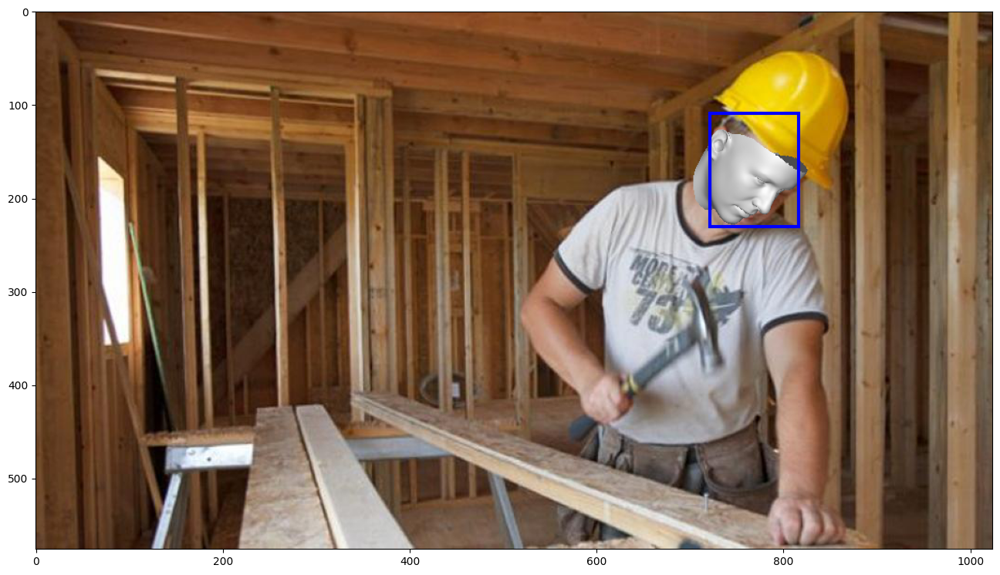

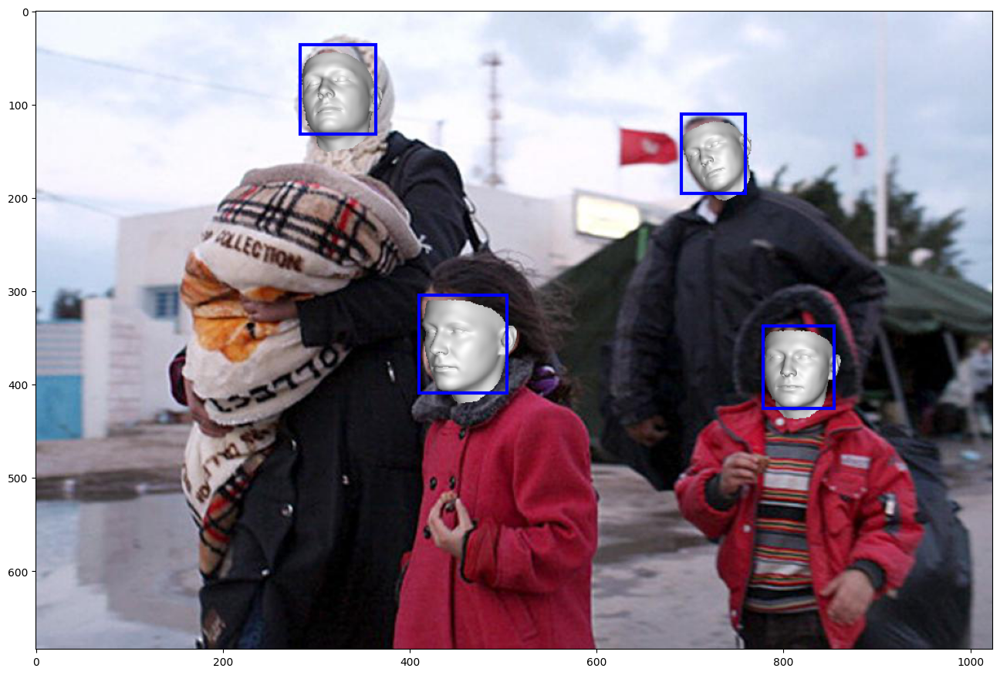

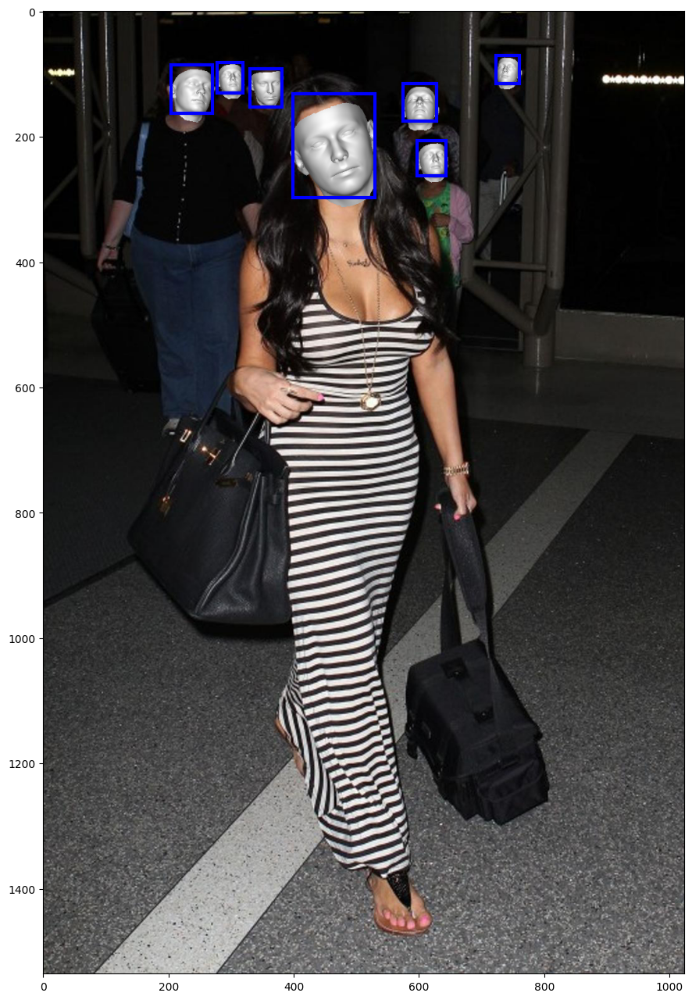

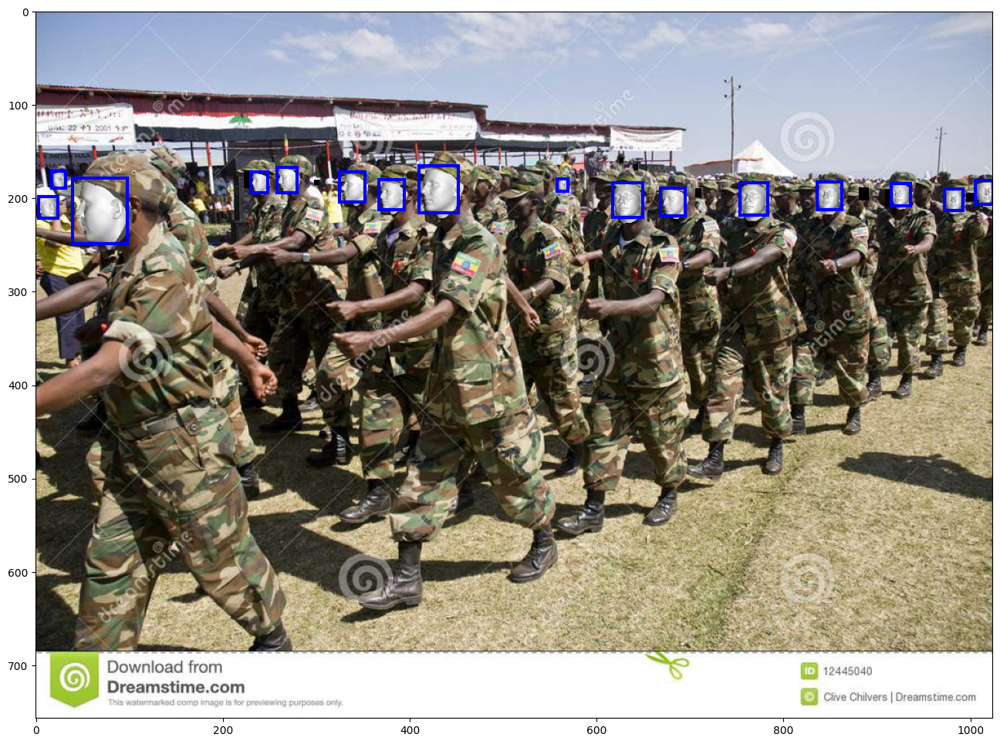

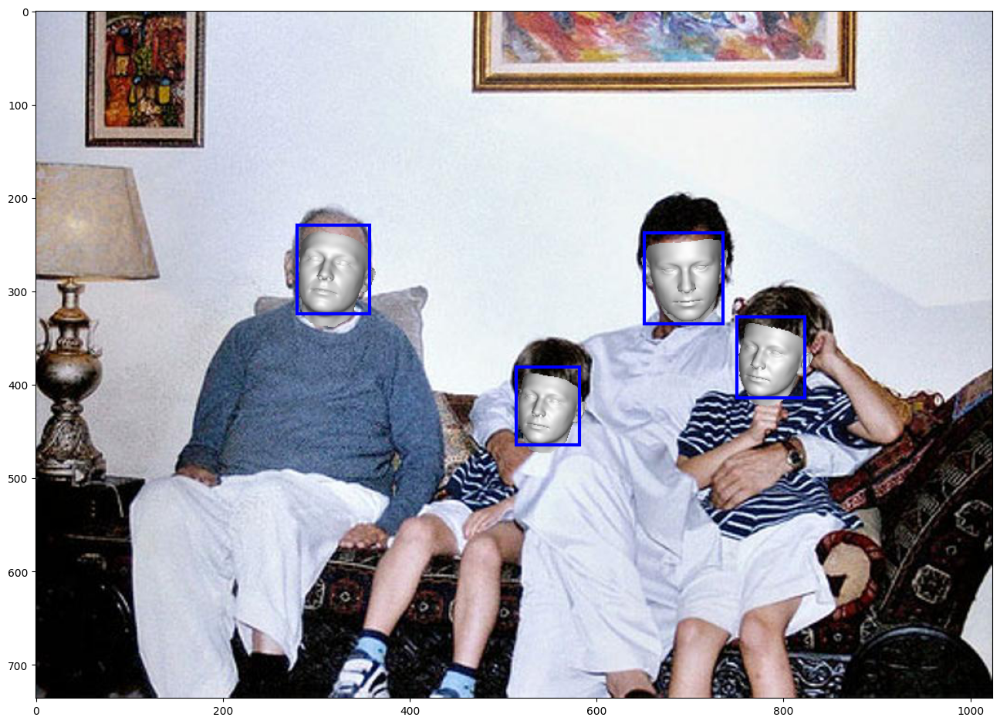

...

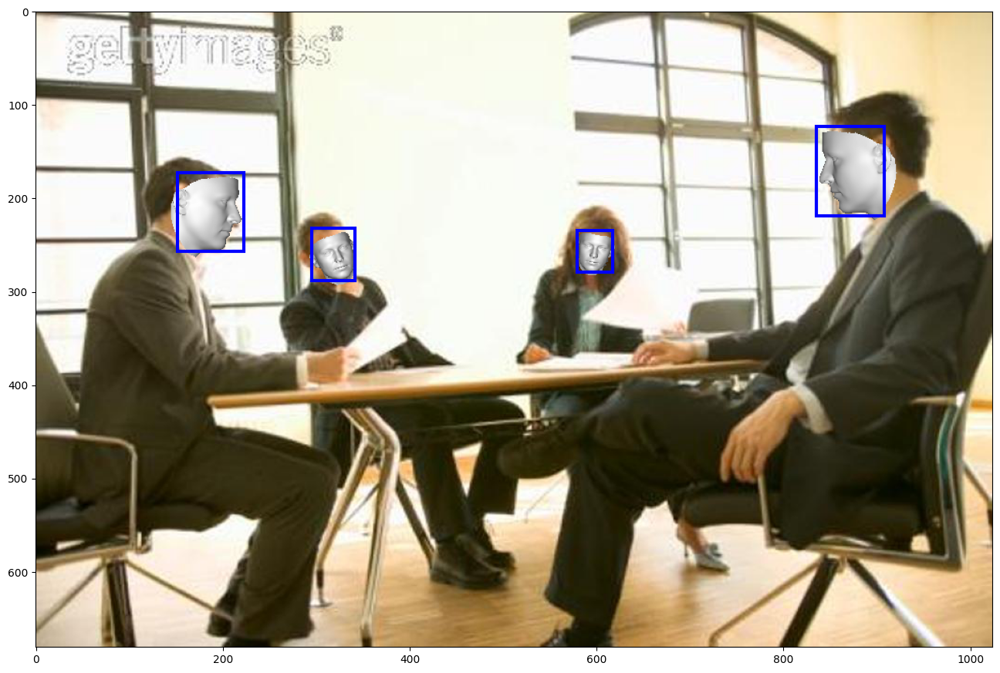

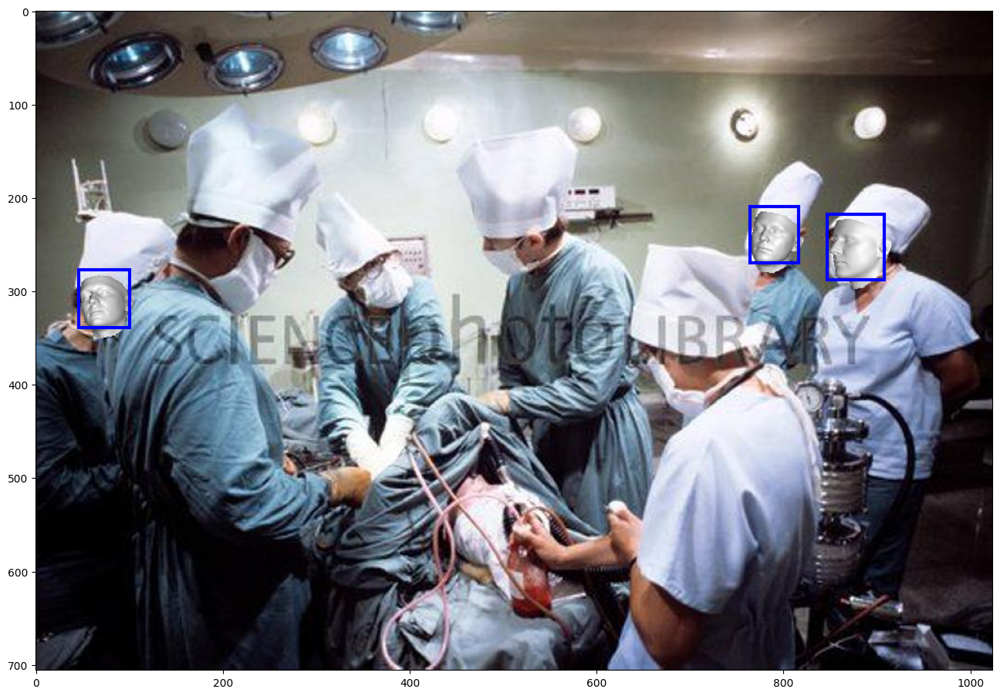

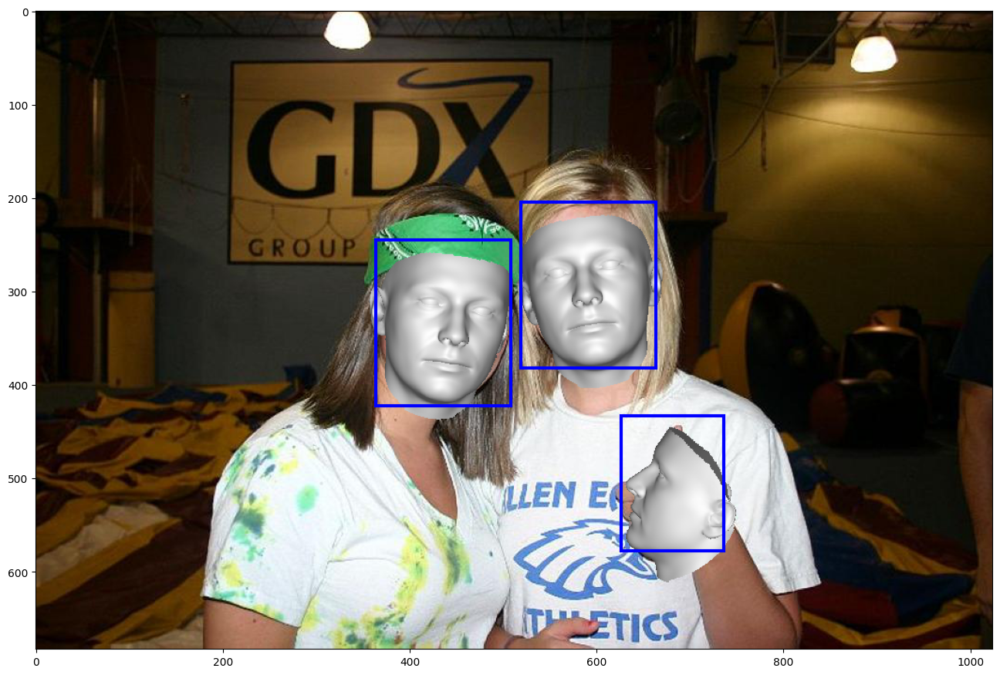

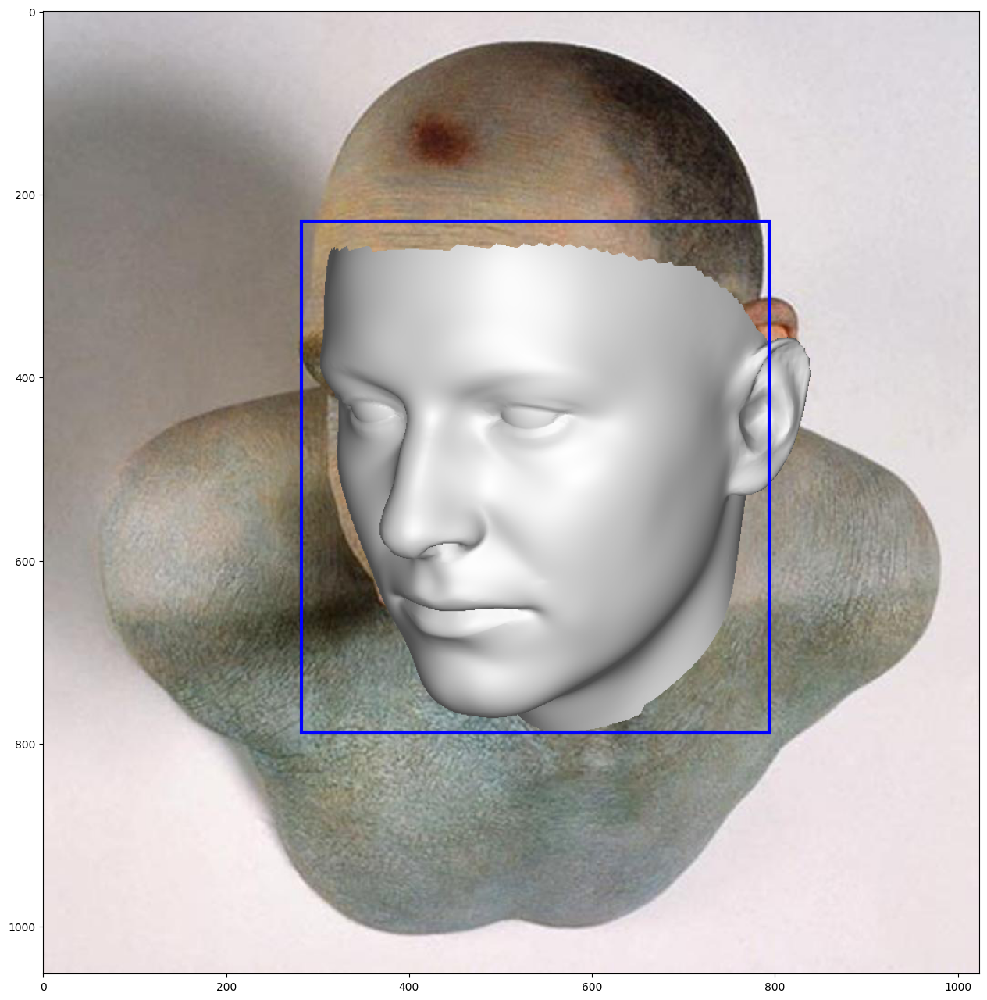

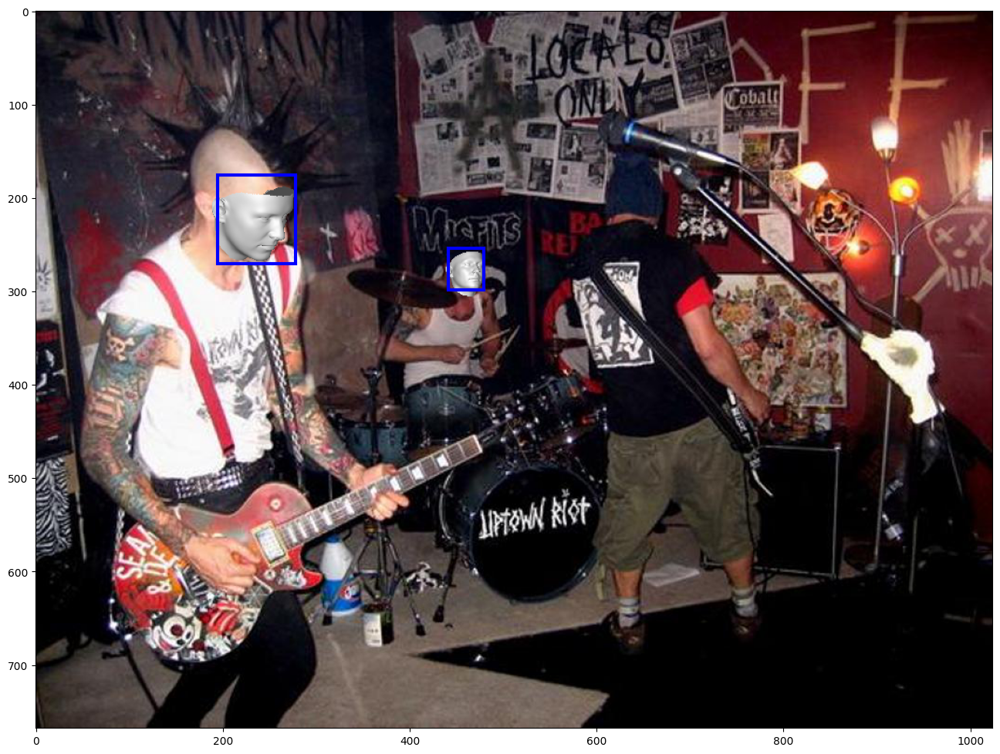

In [ ]:
threshold = 0.8
total_imgs = 20

data_iter = iter(lmdb_data_loader)

for j in tqdm(range(total_imgs)):
    torch_img, target = next(data_iter)
    target = target[0]
        
    bboxes = []
    scores = []
    poses = []
    
    img = torch_img[0]
    img = img.squeeze()
    img = transforms.ToPILImage()(img).convert("RGB")
    ori_img = img.copy()
    

    run_img = img.copy()

    w, h = img.size

    min_size = min(w, h)
    max_size = max(w, h)
    
    # run on the original image size
    img2pose_model.fpn_model.module.set_max_min_size(max_size, min_size)

    res = img2pose_model.predict([transform(run_img)])
    res = res[0]

    for i in range(len(res["scores"])):
        if res["scores"][i] > threshold:
            bboxes.append(res["boxes"].cpu().numpy()[i].astype('int'))
            scores.append(res["scores"].cpu().numpy()[i].astype('float'))
            poses.append(res["dofs"].cpu().numpy()[i].astype('float'))
                
    (w, h) = img.size
    image_intrinsics = np.array([[w + h, 0, w // 2], [0, w + h, h // 2], [0, 0, 1]])
    
    plt.figure(figsize=(16, 16))    
    
    poses = np.asarray(poses)
    bboxes = np.asarray(bboxes)
    scores = np.asarray(scores)
    
    if np.ndim(bboxes) == 1 and len(bboxes) > 0:
        bboxes = bboxes[np.newaxis, :]
        poses = poses[np.newaxis, :]        
        
    if len(bboxes) != 0:
        ranked = np.argsort(poses[:, 5])[::-1]
        poses = poses[ranked]
        bboxes = bboxes[ranked]
        scores = scores[ranked]

        for i in range(len(scores)):
            if scores[i] > threshold:
                bbox = bboxes[i]

                pose_pred = poses[i]
                pose_pred = np.asarray(pose_pred.squeeze())        

                trans_vertices = renderer.transform_vertices(img, [pose_pred])
                img = renderer.render(img, trans_vertices, alpha=1)  
                plt.gca().add_patch(patches.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1],linewidth=3,edgecolor='b',facecolor='none'))            
                img = Image.fromarray(img)

        plt.imshow(img)        
        plt.show() 